In [1]:
import os
import subprocess
import re
import pandas as pd
import numpy as np
import shutil

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import matplotlib.patheffects as path_effects
import plotly.express as px
import scipy.cluster.hierarchy as sch
from tqdm import tqdm
from collections import defaultdict

In [2]:
# load data 
df  = pd.read_parquet("../bldb/clean/csv/bldb_dset.parquet")
sbl = df[df.bla_class.str.contains("class_a|class_c|class_d")]

# load tsne
tsne_sbl = pd.read_parquet("../bldb/lowdim/tsne/csv/tsne_sbl_all_models.csv")

# merge 
sbl = sbl.merge(tsne_sbl, on="seq_id", how="inner")

# split
sbl_c = sbl[sbl.bla_class == "class_c"]

# print info
print(sbl_c.columns.to_list())

# plot fx
def do_iscatter_normal(df, x, y, hue, hover_name, hover_data):

    # plot
    fig = px.scatter(df, x=x, y=y,
    height=500, width=600, color=hue,
    hover_name=hover_name, 
    color_discrete_sequence=px.colors.qualitative.Plotly,
    hover_data=hover_data
    )

    fig.update_traces(marker=dict(size=8, line=dict(width=1,color='black')),selector=dict(mode='markers'))
    fig.update_layout(template="plotly_white")
    fig.update_yaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.update_xaxes(showline=True, linewidth=1, linecolor='LightGrey')
    fig.show()

['#name', 'seq', 'length', 'filename', 'bla_class', 'protein_name', 'protein_family_filename', 'superfamily', 'protein_family', 'top_fam', 'seq_id', 'ambler_class', 'alternative_protein_name', 'subfamily', 'genpept_id', 'genbank_id', 'pubmed_id', 'seq_url', 'pdb_structures', 'mutants', 'phenotype', 'functional_info', 'source', 'bitscore', 'Domain', 'Phylum', 'Class', 'Order', 'Family', 'Genus', 'Species', 'phylo_group', 'phylo_group_genus', 'phylo_group_sp', 'bla_subclass', 'esm1b', 'esm2_650m', 'esm2_3b', 'carp', 't5xlu50', 'molecular_weight', 'aromaticity', 'instability', 'gravy', 'isoelectric_point', 'entropy', 'helix', 'turn', 'sheet', 'pass_the_filter', 'is_clust_rep_30', 'is_clust_rep_60', 'is_clust_rep_90', 'has_af2_model', 'model', 'mean_plddt', 'resid_plddt', 'entryId', 'gene', 'uniprotAccession', 'uniprotId', 'uniprotDescription', 'taxId', 'organismScientificName', 'uniprotStart', 'uniprotEnd', 'modelCreatedDate', 'latestVersion', 'allVersions', 'isReviewed', 'isReferenceProt

In [3]:
len(sbl_c)

6758

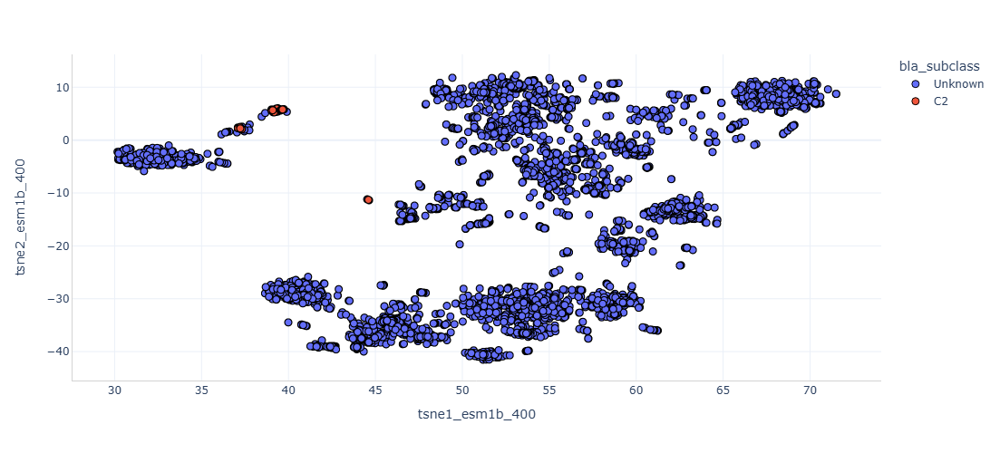

In [4]:
do_iscatter_normal(
    df=sbl_c, x='tsne1_esm1b_400', y='tsne2_esm1b_400', 
    hue="bla_subclass", hover_name="protein_name", hover_data=["#name", "uniprotAccession", "model"])

In [5]:
unmatch = sbl_c[(sbl_c.tsne1_esm1b_400.between(44,45))&(sbl_c.tsne2_esm1b_400.between(-12,-11))].seq_id.to_list()
unmatch

['bldb_019565', 'bldb_019566', 'bldb_019567']

In [6]:
filters = [
    #(sbl_c.tsne1_esm1b_400.between(35,65) & sbl_c.tsne2_esm1b_400.between(-45, -24)),
    #(sbl_c.tsne1_esm1b_400.between(30,37) & sbl_c.tsne2_esm1b_400.between(-6, -0.9)),
    (sbl_c.tsne1_esm1b_400.between(36,40) & sbl_c.tsne2_esm1b_400.between(0, 8)),   
]

values = ["C2"]

sbl_c["group"] = np.select(filters, values)
sbl_c["group"] = sbl_c["group"].str.replace("0", "C1")
sbl_c.loc[sbl_c['seq_id'].isin(unmatch), 'group'] = 'C2'

/tmp/ipykernel_668/4240278555.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_668/4240278555.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



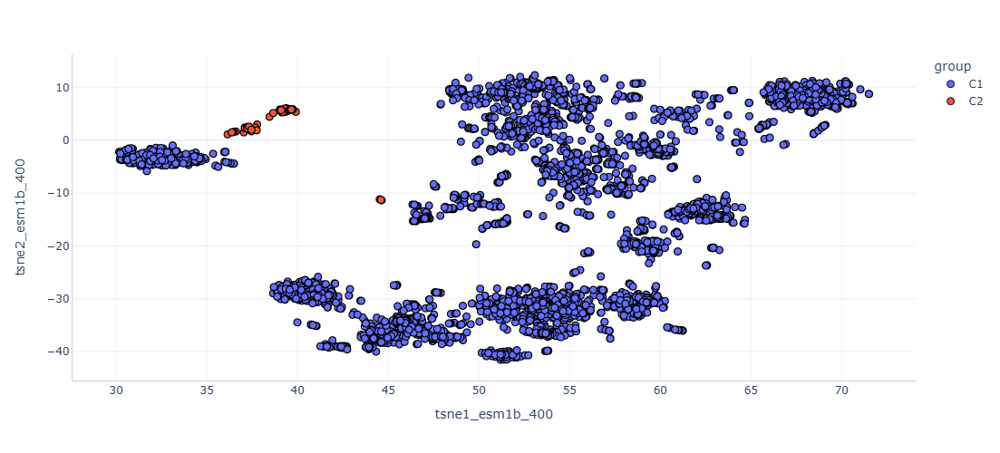

In [7]:
do_iscatter_normal(
    df=sbl_c, x='tsne1_esm1b_400', y='tsne2_esm1b_400', 
    hue="group", hover_name="protein_name", hover_data=["#name", "uniprotAccession", "model"])

[Text(0, 0, '6595'), Text(0, 0, '163')]

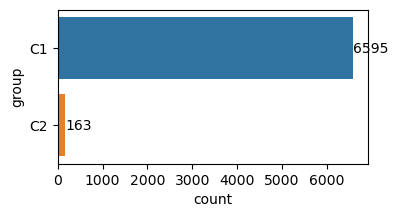

In [8]:
plt.figure(figsize=(4,2))
ax=sns.countplot(sbl_c, y="group")
ax.bar_label(ax.containers[0])

Text(0.5, 1.0, 'rep90')

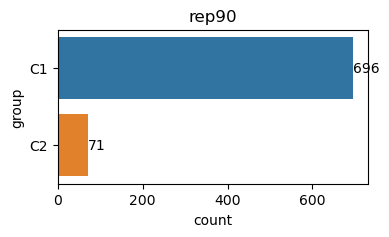

In [9]:
plt.figure(figsize=(4,2))
ax=sns.countplot(sbl_c[sbl_c.is_clust_rep_90 == "yes"], y="group")
ax.bar_label(ax.containers[0])
plt.title("rep90")

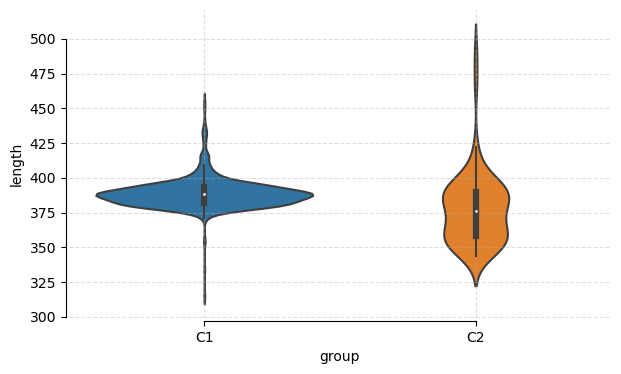

In [10]:
plt.figure(figsize=(7,4))
ax = sns.violinplot(sbl_c[sbl_c.is_clust_rep_90 == "yes"], y="length", x="group")
sns.despine(trim=True, offset=2)
ax.grid(alpha=0.4, linestyle="--")

In [11]:
c1 = sbl_c[(sbl_c.is_clust_rep_90 == "yes") & (~sbl_c.group.str.contains("C2"))]
c2 = sbl_c[(sbl_c.is_clust_rep_90 == "yes") & (sbl_c.group.str.contains("C2"))]

print(f"seqs in C1: {len(c1)}")
print(f"seqs in C2: {len(c2)}")

seqs in C1: 696
seqs in C2: 71


In [12]:
c2.sort_values("length")[["model", "length"]]

,model,length
15514,AF-A0A1Q7BAI2-F1-model_v4.pdb,344
15741,AF-A0A0R3L3S1-F1-model_v4.pdb,346
15745,AF-A0A1B9Z423-F1-model_v4.pdb,347
15735,None,351
21143,None,351
...,...,...
19561,AF-Q5ZSV4-F1-model_v4.pdb,407
15731,AF-A0A0E4FZF5-F1-model_v4.pdb,413
16324,AF-A0A2N2F5X1-F1-model_v4.pdb,422
19138,AF-A0A2N4X815-F1-model_v4.pdb,468


In [13]:
# a fx to export fasta seqs
def export_fasta(df, output_file):
    with open(output_file, 'w') as f:
        for index, row in df.iterrows():
            f.write(f'>{row["seq_id"]}\n')
            f.write(f'{row["seq"]}\n')
 
export_fasta(c1,"../bldb/clean/fasta/class_c/c1_rep90_final.fasta")
export_fasta(c2,"../bldb/clean/fasta/class_c/c2_rep90_final.fasta")

<Axes: xlabel='tsne1_esm1b_400', ylabel='tsne2_esm1b_400'>

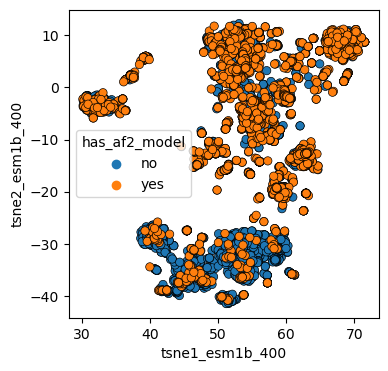

In [14]:
plt.figure(figsize=(4,4))
sns.scatterplot(sbl_c.sort_values("has_af2_model"), 
                x="tsne1_esm1b_400", y="tsne2_esm1b_400", 
                edgecolor="k", hue="has_af2_model", )

af2 models = 2337


[Text(0, 0, '2263'), Text(0, 0, '74')]

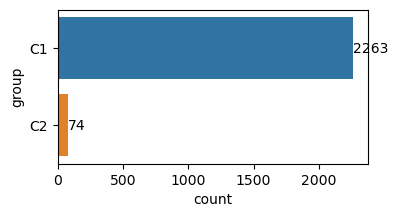

In [15]:
af2 = sbl_c[sbl_c.has_af2_model == "yes"]
af2 = af2.reset_index(drop=True)

print(f"af2 models = {len(af2)}")

plt.figure(figsize=(4,2))
ax=sns.countplot(af2, y="group")
ax.bar_label(ax.containers[0])

[Text(0, 0, '383'), Text(0, 0, '44')]

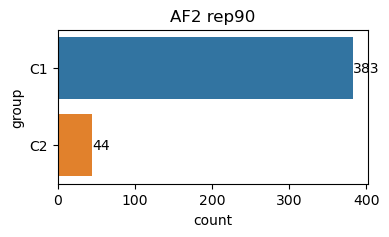

In [16]:
plt.figure(figsize=(4,2))
ax=sns.countplot(af2[af2.is_clust_rep_90=="yes"], y="group")
plt.title("AF2 rep90")
ax.bar_label(ax.containers[0])

In [17]:
af2_rep = af2[af2.is_clust_rep_90=="yes"]

af2_c01 = af2_rep[af2_rep.group == "C1"]
af2_c02 = af2_rep[af2_rep.group == "C2"]

#af2_c01 = af2_c01.sample(40, random_state = 37)

names_c01 = af2_c01.model.to_list() 
names_c02 = af2_c02.model.to_list() 


models = names_c01 + names_c02  
len(models)

427

In [18]:
af2_c02.model.to_list()

['AF-A0A1Q7BAI2-F1-model_v4.pdb',
 'AF-A0A2M8R873-F1-model_v4.pdb',
 'AF-A0A0S6UYA9-F1-model_v4.pdb',
 'AF-A0A0X8CJL5-F1-model_v4.pdb',
 'AF-A0A1Q5SC68-F1-model_v4.pdb',
 'AF-A0A1I5JRQ1-F1-model_v4.pdb',
 'AF-A0A176Z1I5-F1-model_v4.pdb',
 'AF-A0A0E4FZF5-F1-model_v4.pdb',
 'AF-A0A2A6PXS3-F1-model_v4.pdb',
 'AF-A0A150U726-F1-model_v4.pdb',
 'AF-A0A257KTN7-F1-model_v4.pdb',
 'AF-A0A1M5KSS1-F1-model_v4.pdb',
 'AF-A0A0R3L3S1-F1-model_v4.pdb',
 'AF-A0A1B9Z423-F1-model_v4.pdb',
 'AF-A0A2K8YCN2-F1-model_v4.pdb',
 'AF-A0A2A2VFU2-F1-model_v4.pdb',
 'AF-A0A2A6NYE4-F1-model_v4.pdb',
 'AF-A0A1G6YBU7-F1-model_v4.pdb',
 'AF-A0A2N2F5X1-F1-model_v4.pdb',
 'AF-A0A1M3CPB4-F1-model_v4.pdb',
 'AF-A0A2N4X815-F1-model_v4.pdb',
 'AF-A0A1G0GUA0-F1-model_v4.pdb',
 'AF-A0A1G0HVX8-F1-model_v4.pdb',
 'AF-A0A357MR87-F1-model_v4.pdb',
 'AF-Q5ZSV4-F1-model_v4.pdb',
 'AF-A0A078KSR3-F1-model_v4.pdb',
 'AF-A0A098G3T6-F1-model_v4.pdb',
 'AF-A0A0W0YYQ6-F1-model_v4.pdb',
 'AF-A0A378JVI9-F1-model_v4.pdb',
 'AF-A0A378KWB1-F1

In [19]:
pdb_files = "../bldb/af2/pdbs/"
clone_dir = "../bldb/af2/class_c/only_c2_44blas/"

In [20]:
# copy the files 
#for pdb in tqdm(af2_c02.model.to_list(), desc="Working"):
#    filename = os.path.join(pdb_files, pdb)
#    if os.path.exists(filename):
#        shutil.copy(filename, clone_dir)

In [21]:
pdb_files = "../bldb/af2/pdbs/"
clone_dir = "../bldb/af2/class_c/comparison/"

In [22]:
# copy the files 
#for pdb in tqdm(models, desc="Working"):
#    filename = os.path.join(pdb_files, pdb)
#    if os.path.exists(filename):
#        shutil.copy(filename, clone_dir)

foldseek createdb ../../*.pdb db

foldseek easy-search db/db db/db foldseek_results.csv tmp --alignment-type 1 --format-output "query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob" --exhaustive-search 1 --tmscore-threshold 0.0 -e inf

In [23]:
# https://mmseqs.com/latest/userguide.pdf
foldseek_cols = ['query', 'target', 'rmsd', 'alntmscore', 'fident', 'lddt', 'evalue', 'bits', 'prob']

foldseek = pd.read_csv("../bldb/af2/class_c/comparison/foldseek/foldseek_results.csv", sep="\t", names=foldseek_cols)

# rename the files in the df 
def rename_file(name, names_lists):
    for prefix, names_list in names_lists.items():
        if name in names_list:
            return f"{prefix}-{name}"
    return name

# format list as dict 
names_lists = {"C1": names_c01, "C2": names_c02}

# apply the rename-fx 
foldseek["query"]  = foldseek["query"].apply(lambda x: rename_file(x, names_lists))
foldseek["target"] = foldseek["target"].apply(lambda x: rename_file(x, names_lists))
foldseek

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-L0MG14-F1-model_v4.pdb,0.007622,1.0000,1.000,1.0000,1.0000,0,0.000
1,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-Q1I188-F1-model_v4.pdb,1.059000,0.9861,0.681,0.9672,0.9823,98,0.999
2,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-A0A0G3CFM7-F1-model_v4.pdb,0.888500,0.9888,0.642,0.9665,0.9764,98,0.999
3,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-A0A240C041-F1-model_v4.pdb,1.375000,0.9827,0.669,0.9708,0.9739,97,0.999
4,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-V5R1L5-F1-model_v4.pdb,1.276000,0.9794,0.615,0.9646,0.9733,97,0.999
...,...,...,...,...,...,...,...,...,...
182324,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-Q5ZSV4-F1-model_v4.pdb,2.146000,0.8309,0.264,0.7350,0.7731,78,0.978
182325,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-A0A2I0P428-F1-model_v4.pdb,2.632000,0.7841,0.210,0.7074,0.7698,77,0.975
182326,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C1-AF-A0A4P6A1I7-F1-model_v4.pdb,2.958000,0.7819,0.184,0.6442,0.7595,75,0.967
182327,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-F4CDQ9-F1-model_v4.pdb,2.201000,0.8202,0.231,0.7157,0.7063,78,0.978


In [27]:
xd = sns.load_dataset("brain_networks", header=[0, 1, 2], index_col=0)

used_networks = [1, 5, 6, 7, 8, 12, 13, 17]
used_columns = (xd.columns
                  .get_level_values("network")
                  .astype(int)
                  .isin(used_networks))
xd = xd.loc[:, used_columns]

xd.columns = xd.columns.map("-".join)

# Compute a correlation matrix and convert to long-form
corr_mat = xd.corr().stack().reset_index(name="correlation")
corr_mat

,level_0,level_1,correlation
0,1-1-lh,1-1-lh,1.000000
1,1-1-lh,1-1-rh,0.881516
2,1-1-lh,5-1-lh,0.431619
3,1-1-lh,5-1-rh,0.418708
4,1-1-lh,6-1-lh,-0.084634
...,...,...,...
1439,17-4-lh,17-2-lh,0.517481
1440,17-4-lh,17-2-rh,0.256544
1441,17-4-lh,17-3-lh,0.264381
1442,17-4-lh,17-3-rh,0.090302


In [31]:
df_pivot = foldseek.pivot(index='query', columns='target', values='rmsd')
df_stack = df_pivot.stack().reset_index(name='rmsd')
df_stack

,query,target,rmsd
0,C1-AF-A0A010SUD7-F1-model_v4.pdb,C1-AF-A0A010SUD7-F1-model_v4.pdb,0.000
1,C1-AF-A0A010SUD7-F1-model_v4.pdb,C1-AF-A0A022FVB8-F1-model_v4.pdb,1.921
2,C1-AF-A0A010SUD7-F1-model_v4.pdb,C1-AF-A0A024E6Y8-F1-model_v4.pdb,1.759
3,C1-AF-A0A010SUD7-F1-model_v4.pdb,C1-AF-A0A031IWM4-F1-model_v4.pdb,1.534
4,C1-AF-A0A010SUD7-F1-model_v4.pdb,C1-AF-A0A059L3Q3-F1-model_v4.pdb,1.779
...,...,...,...
182324,C2-AF-Q5ZSV4-F1-model_v4.pdb,C2-AF-D6MLY8-F1-model_v4.pdb,1.983
182325,C2-AF-Q5ZSV4-F1-model_v4.pdb,C2-AF-F4CDQ9-F1-model_v4.pdb,2.456
182326,C2-AF-Q5ZSV4-F1-model_v4.pdb,C2-AF-I9NK21-F1-model_v4.pdb,2.266
182327,C2-AF-Q5ZSV4-F1-model_v4.pdb,C2-AF-L7UG55-F1-model_v4.pdb,2.134


<Figure size 600x600 with 0 Axes>

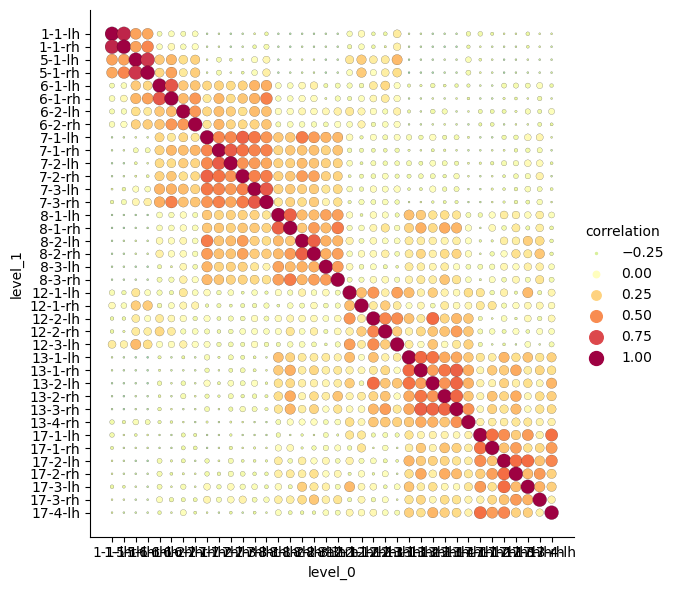

In [49]:
plt.figure(figsize=(6, 6))
g = sns.relplot(
    data=corr_mat,  
    x="level_0", y="level_1", hue="correlation", size="correlation",
    palette="Spectral_r", hue_norm=(-1, 1), edgecolor="k",
    height=6, sizes=(2, 100), size_norm=(-.2, .8),  
)
plt.x

In [24]:
def plot_clustermap(df, values_col, cbar_label, palette):
    # create a sim matrix 
    df_sim = df.pivot(index='query', columns='target', values=values_col)

    # create a color palette and handles
    colors = df_sim.index.str[:2].map({
        "C1": "royalblue", 
        "C2": "orange",
    })
    lut = dict(zip(df_sim.index.str[:2].to_list(), colors))
    handles = [Patch(facecolor = lut[name]) for name in lut]

    # plot
    g = sns.clustermap(
        figsize=(6, 6),
        data = df_sim.to_numpy().astype(float), 
        method = "ward", metric = "euclidean", 
        annot = False, cmap = palette,
        row_colors = colors.to_list(), 
        col_colors = colors.to_list(), 
        xticklabels = False, yticklabels = False, # False, df_sim.index
        cbar_kws={"label": cbar_label}, 
        cbar_pos = (0.03, 0.77, 0.05, 0.2))

    g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize = 5)
    g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_xticklabels(), fontsize = 5)
    plt.legend(
        handles, lut, 
        title = "Subclass", loc = "best", 
        frameon = False, ncol = 1,
        bbox_to_anchor = (1, 1), 
        bbox_transform = plt.gcf().transFigure, 
        prop = {'size': 10})

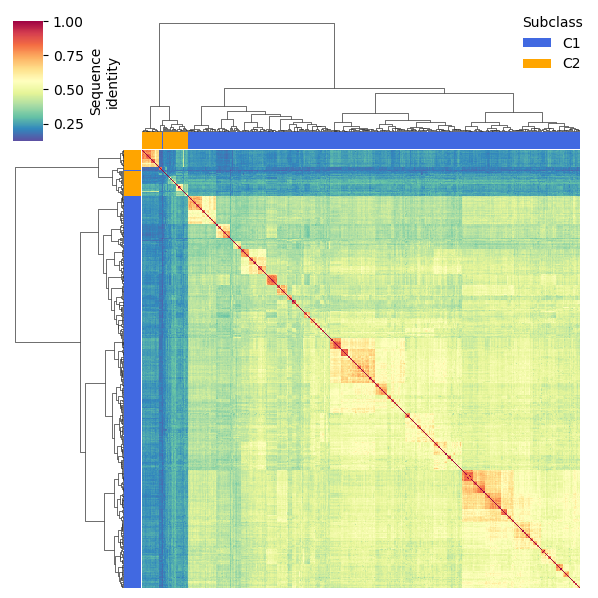

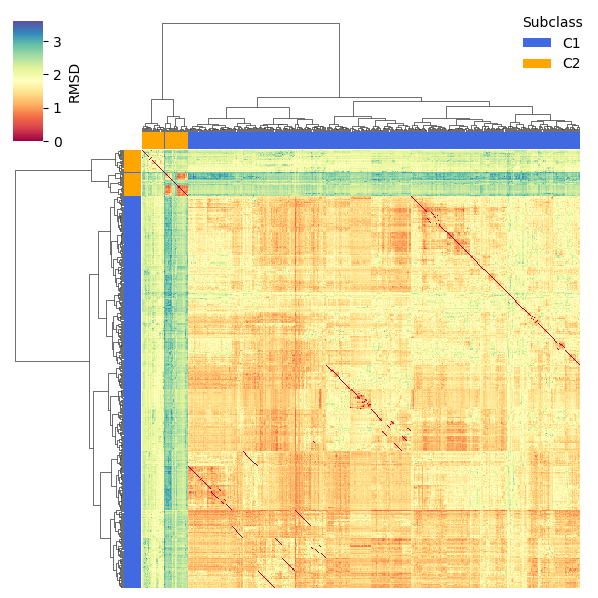

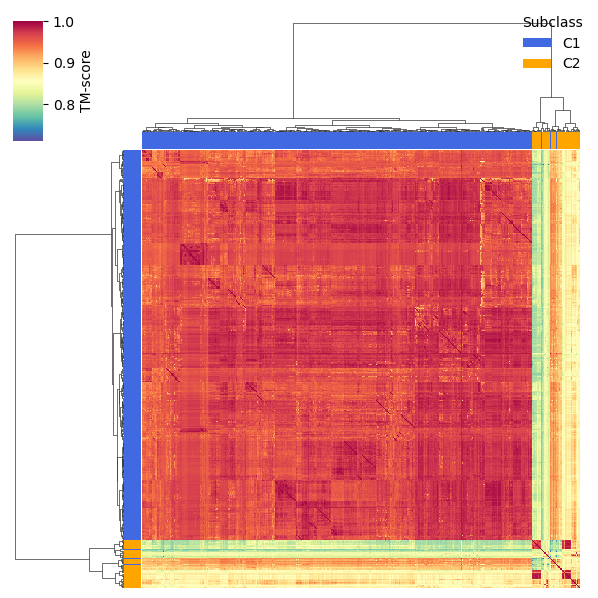

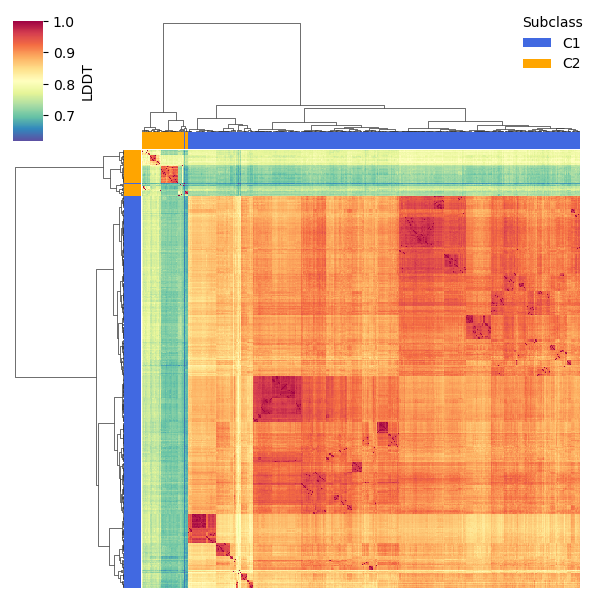

In [24]:
plot_clustermap(foldseek, 'fident', 'Sequence\nidentity', "Spectral_r")
plot_clustermap(foldseek, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(foldseek, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(foldseek, 'lddt', 'LDDT', "Spectral_r")

After a manual inspection with chimeraX we detected the follow blas withoit the c2
1. AF-A0A0W0SW84-F1-model_v4.pdb
1. AF-A0A1G0GUA0-F1-model_v4.pdb
1. AF-A0A1G0HVX8-F1-model_v4.pdb
1. AF-A0A1G0WYI0-F1-model_v4.pdb
1. AF-A0A2N2F5X1-F1-model_v4.pdb
1. AF-A0A059X9F8-F1-model_v4.pdb
1. AF-A0A357MR87-F1-model_v4.pdb
1. AF-D6MLY8-F1-model_v4.pdb
1. AF-I9NK21-F1-model_v4.pdb

And this with fused folds 
1. AF-A0A2N4X815-F1-model_v4.pdb
1. AF-F4CDQ9-F1-model_v4.pdb

therefore we removed it from the dset 

In [43]:
# after a chimerax check we detected this outliers 
chim_outliers = [
    # is C1
    "C2-AF-D6MLY8-F1-model_v4.pdb", 
    "C2-AF-I9NK21-F1-model_v4.pdb", 
    "C2-AF-A0A0W0SW84-F1-model_v4.pdb", 
    "C2-AF-A0A1G0GUA0-F1-model_v4.pdb", 
    "C2-AF-A0A1G0HVX8-F1-model_v4.pdb", 
    "C2-AF-A0A1G0WYI0-F1-model_v4.pdb", 
    "C2-AF-A0A2N2F5X1-F1-model_v4.pdb", 
    "C2-AF-A0A059X9F8-F1-model_v4.pdb", 
    "C2-AF-A0A357MR87-F1-model_v4.pdb", 
    
    # fused folds
    "C2-AF-F4CDQ9-F1-model_v4.pdb",
    "C2-AF-A0A2N4X815-F1-model_v4.pdb"
]

foldseek_clean = foldseek[~foldseek['query'].isin(chim_outliers) & ~foldseek['target'].isin(chim_outliers)]
foldseek_clean

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-L0MG14-F1-model_v4.pdb,0.007622,1.0000,1.000,1.0000,1.0000,0,0.000
1,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-Q1I188-F1-model_v4.pdb,1.059000,0.9861,0.681,0.9672,0.9823,98,0.999
2,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-A0A0G3CFM7-F1-model_v4.pdb,0.888500,0.9888,0.642,0.9665,0.9764,98,0.999
3,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-A0A240C041-F1-model_v4.pdb,1.375000,0.9827,0.669,0.9708,0.9739,97,0.999
4,C1-AF-L0MG14-F1-model_v4.pdb,C1-AF-V5R1L5-F1-model_v4.pdb,1.276000,0.9794,0.615,0.9646,0.9733,97,0.999
...,...,...,...,...,...,...,...,...,...
182322,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-L7UG55-F1-model_v4.pdb,2.635000,0.8184,0.197,0.7026,0.7832,75,0.967
182323,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-A0A0E4FZF5-F1-model_v4.pdb,2.928000,0.8124,0.202,0.6898,0.7789,79,0.981
182324,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-Q5ZSV4-F1-model_v4.pdb,2.146000,0.8309,0.264,0.7350,0.7731,78,0.978
182325,C1-AF-A0A7U4TK59-F1-model_v4.pdb,C2-AF-A0A2I0P428-F1-model_v4.pdb,2.632000,0.7841,0.210,0.7074,0.7698,77,0.975


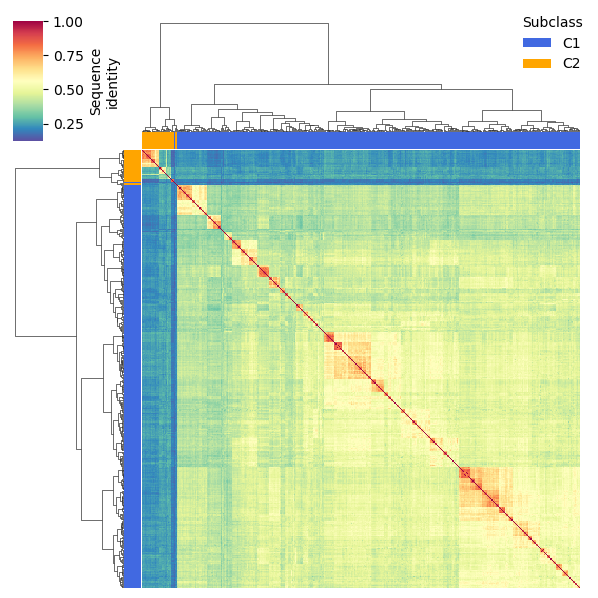

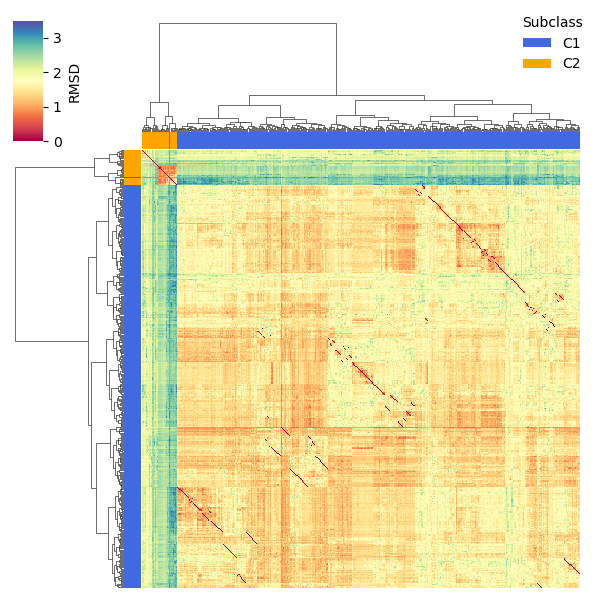

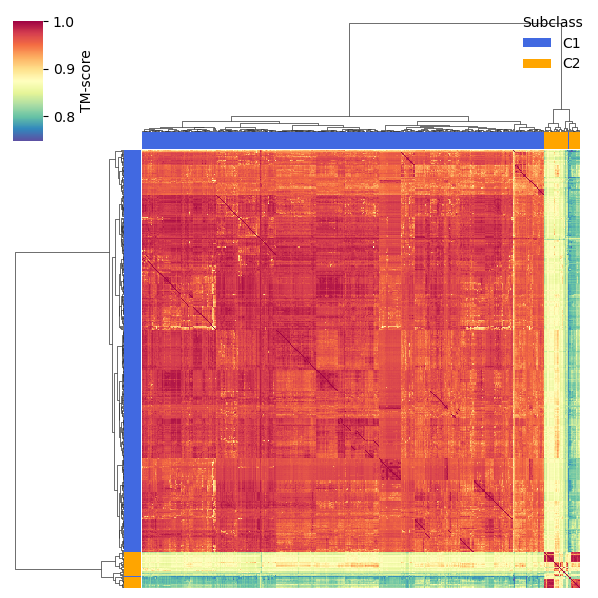

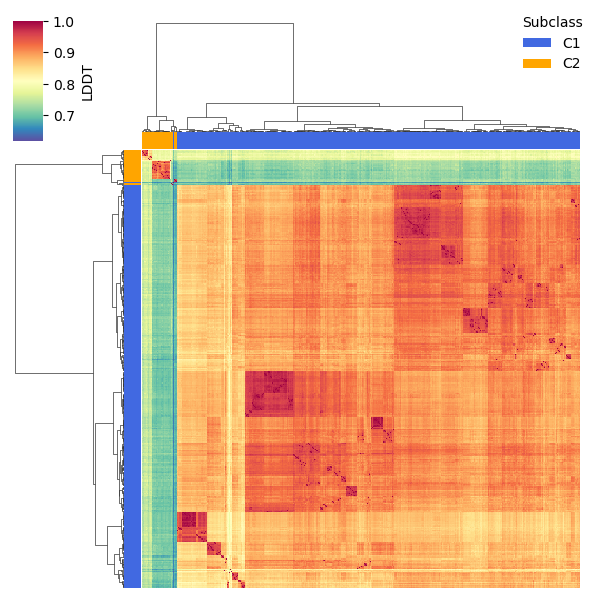

In [44]:
plot_clustermap(foldseek_clean, 'fident', 'Sequence\nidentity', "Spectral_r")
plot_clustermap(foldseek_clean, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(foldseek_clean, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(foldseek_clean, 'lddt', 'LDDT', "Spectral_r")

In [45]:
# https://stackoverflow.com/questions/27924813/extracting-clusters-from-seaborn-clustermap
def get_cluster_classes(den, label='ivl'):
    cluster_idxs = defaultdict(list)
    for c, pi in zip(den['color_list'], den['icoord']):
        for leg in pi[1:3]:
            i = (leg - 5.0) / 10.0
            if abs(i - int(i)) < 1e-5:
                cluster_idxs[c].append(int(i))

    cluster_classes = {}
    for c, l in cluster_idxs.items():
        i_l = [den[label][i] for i in l]
        cluster_classes[c] = i_l

    return cluster_classes

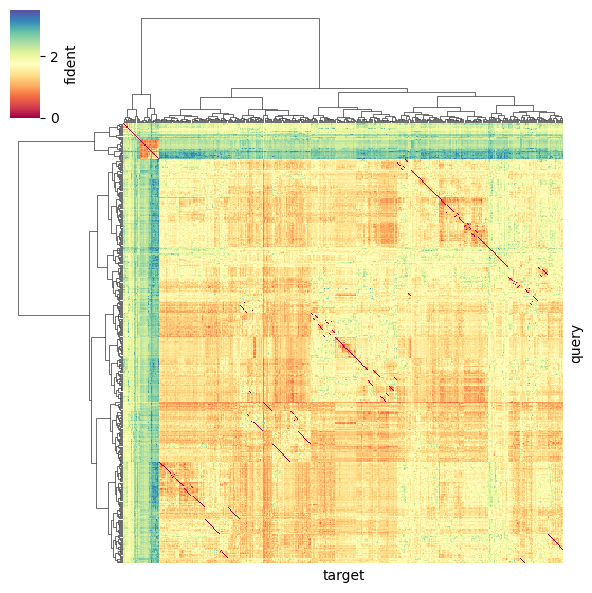

In [48]:
sq_mat = foldseek_clean.pivot(index='query', columns='target', values="rmsd")

g = sns.clustermap(sq_mat, method="ward", metric="euclidean", figsize=(6,6),
    cmap="Spectral", xticklabels=False, yticklabels=False, cbar_kws={"label": "fident"})

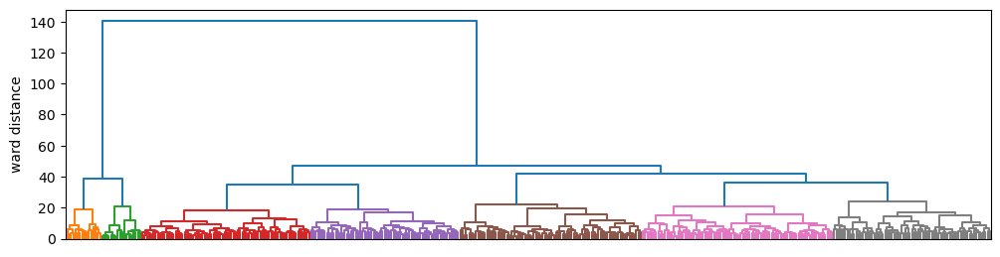

Cluster 'C1' has 16 items
Cluster 'C2' has 18 items
Cluster 'C3' has 78 items
Cluster 'C4' has 68 items
Cluster 'C5' has 82 items
Cluster 'C6' has 88 items
Cluster 'C7' has 71 items


In [59]:
plt.figure(figsize=(12, 3))
# color_threshold set the distance theshold
den = sch.dendrogram(g.dendrogram_col.linkage, labels = sq_mat.index, color_threshold=25, no_labels=True) 
plt.ylabel("ward distance")
labels = plt.gca().get_xticklabels(False)   
plt.show()

# the fifth cluster , or purple, is the outlier 
clusters = get_cluster_classes(den)
for key, value in clusters.items():
    print(f"Cluster '{key}' has {len(value)} items")

In [60]:
clusters.keys()

dict_keys(['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7'])

In [61]:
# https://alphafold.ebi.ac.uk/entry/A0A1I5JRQ1 strange 
clusters["C2"]

['C2-AF-A0A150U726-F1-model_v4.pdb',
 'C2-AF-A0A176Z1I5-F1-model_v4.pdb',
 'C2-AF-A0A1I5JRQ1-F1-model_v4.pdb',
 'C2-AF-A0A1Q5SC68-F1-model_v4.pdb',
 'C2-AF-A0A0R3L3S1-F1-model_v4.pdb',
 'C2-AF-A0A1B9Z423-F1-model_v4.pdb',
 'C2-AF-A0A0X8CJL5-F1-model_v4.pdb',
 'C2-AF-A0A1M5KSS1-F1-model_v4.pdb',
 'C2-AF-A0A2M8R873-F1-model_v4.pdb',
 'C2-AF-A0A257KTN7-F1-model_v4.pdb',
 'C2-AF-A0A1G6YBU7-F1-model_v4.pdb',
 'C2-AF-A0A2K8YCN2-F1-model_v4.pdb',
 'C2-AF-A0A2A6NYE4-F1-model_v4.pdb',
 'C2-AF-A0A0S6UYA9-F1-model_v4.pdb',
 'C2-AF-A0A2A2VFU2-F1-model_v4.pdb',
 'C2-AF-A0A0E4FZF5-F1-model_v4.pdb',
 'C2-AF-A0A2A6PXS3-F1-model_v4.pdb',
 'C1-AF-A0A4P6A1I7-F1-model_v4.pdb']

# inspect clusters OLD

In [25]:
# https://stackoverflow.com/questions/27924813/extracting-clusters-from-seaborn-clustermap
def get_cluster_classes(den, label='ivl'):
    cluster_idxs = defaultdict(list)
    for c, pi in zip(den['color_list'], den['icoord']):
        for leg in pi[1:3]:
            i = (leg - 5.0) / 10.0
            if abs(i - int(i)) < 1e-5:
                cluster_idxs[c].append(int(i))

    cluster_classes = {}
    for c, l in cluster_idxs.items():
        i_l = [den[label][i] for i in l]
        cluster_classes[c] = i_l

    return cluster_classes

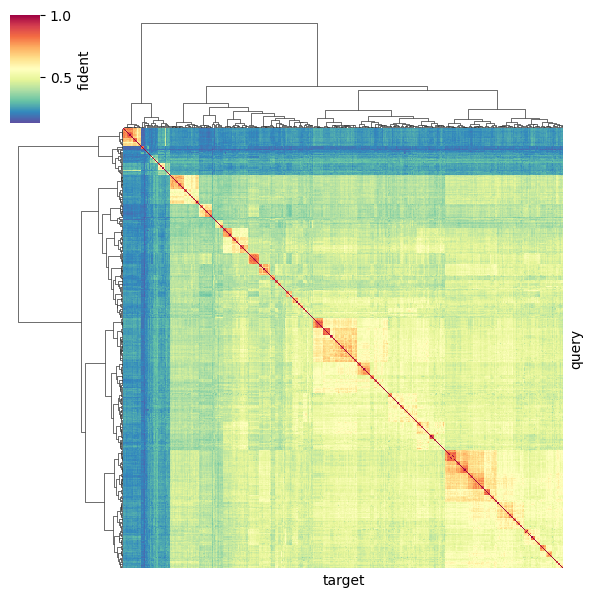

In [26]:
sq_mat = foldseek.pivot(index='query', columns='target', values="fident")

g = sns.clustermap(sq_mat, method="ward", metric="euclidean", figsize=(6,6),
    cmap="Spectral_r", xticklabels=False, yticklabels=False, cbar_kws={"label": "fident"})

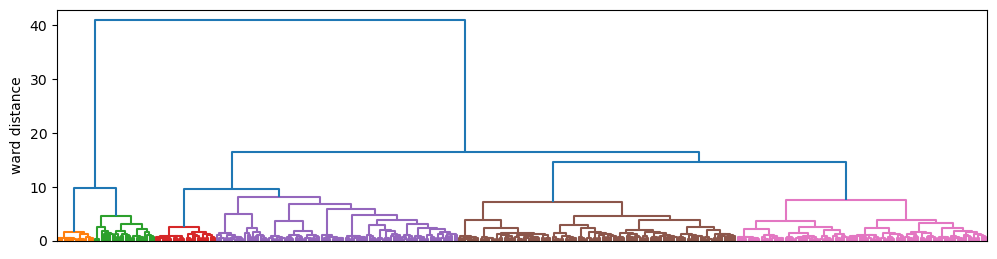

Cluster 'C1' has 17 items
Cluster 'C2' has 29 items
Cluster 'C3' has 28 items
Cluster 'C4' has 112 items
Cluster 'C5' has 131 items
Cluster 'C6' has 119 items


In [27]:
plt.figure(figsize=(12, 3))
# color_threshold set the distance theshold
den = sch.dendrogram(g.dendrogram_col.linkage, labels = sq_mat.index, color_threshold=9, no_labels=True) 
plt.ylabel("ward distance")
labels = plt.gca().get_xticklabels(False)
#for i, label in enumerate(labels):
#    if i % 10 != 0:
#        label.set_visible(False)        
plt.show()

# the fifth cluster , or purple, is the outlier 
clusters = get_cluster_classes(den)
for key, value in clusters.items():
    print(f"Cluster '{key}' has {len(value)} items")

In [28]:
clean_clust_1 = clusters["C1"]
clean_clust_2 = clusters["C2"]
clean_clust_3 = clusters["C3"]
clean_clust_4 = clusters["C4"]
clean_clust_5 = clusters["C5"]
clean_clust_6 = clusters["C6"]

In [29]:
clean_clust_1

['C2-AF-A0A0E4FZF5-F1-model_v4.pdb',
 'C2-AF-A0A1Q5SC68-F1-model_v4.pdb',
 'C2-AF-A0A176Z1I5-F1-model_v4.pdb',
 'C2-AF-A0A0S6UYA9-F1-model_v4.pdb',
 'C2-AF-A0A0X8CJL5-F1-model_v4.pdb',
 'C2-AF-A0A2M8R873-F1-model_v4.pdb',
 'C2-AF-A0A150U726-F1-model_v4.pdb',
 'C2-AF-A0A2A6PXS3-F1-model_v4.pdb',
 'C2-AF-A0A1I5JRQ1-F1-model_v4.pdb',
 'C2-AF-A0A1G6YBU7-F1-model_v4.pdb',
 'C2-AF-A0A2A6NYE4-F1-model_v4.pdb',
 'C2-AF-A0A2A2VFU2-F1-model_v4.pdb',
 'C2-AF-A0A2K8YCN2-F1-model_v4.pdb',
 'C2-AF-A0A0R3L3S1-F1-model_v4.pdb',
 'C2-AF-A0A1B9Z423-F1-model_v4.pdb',
 'C2-AF-A0A1M5KSS1-F1-model_v4.pdb',
 'C2-AF-A0A257KTN7-F1-model_v4.pdb']

In [30]:
clean_clust_2

['C2-AF-A0A1G3J5R1-F1-model_v4.pdb',
 'C2-AF-A0A2M8JV59-F1-model_v4.pdb',
 'C2-AF-A0A258U9V8-F1-model_v4.pdb',
 'C2-AF-A0A2I0P428-F1-model_v4.pdb',
 'C2-AF-F4CDQ9-F1-model_v4.pdb',
 'C2-AF-L7UG55-F1-model_v4.pdb',
 'C2-AF-A0A2N4X815-F1-model_v4.pdb',
 'C2-AF-D6MLY8-F1-model_v4.pdb',
 'C1-AF-A0A4P6A1I7-F1-model_v4.pdb',
 'C2-AF-A0A0W0SW84-F1-model_v4.pdb',
 'C2-AF-A0A1G0WYI0-F1-model_v4.pdb',
 'C2-AF-A0A2N2F5X1-F1-model_v4.pdb',
 'C2-AF-A0A357MR87-F1-model_v4.pdb',
 'C2-AF-I9NK21-F1-model_v4.pdb',
 'C2-AF-A0A1G0GUA0-F1-model_v4.pdb',
 'C2-AF-A0A1G0HVX8-F1-model_v4.pdb',
 'C2-AF-A0A059X9F8-F1-model_v4.pdb',
 'C2-AF-A0A378JVI9-F1-model_v4.pdb',
 'C2-AF-A0A378KWB1-F1-model_v4.pdb',
 'C2-AF-A0A078KSR3-F1-model_v4.pdb',
 'C2-AF-A0A098G3T6-F1-model_v4.pdb',
 'C2-AF-A0A0W0YYQ6-F1-model_v4.pdb',
 'C2-AF-Q5ZSV4-F1-model_v4.pdb',
 'C2-AF-A0A0C1EPQ2-F1-model_v4.pdb',
 'C2-AF-A0A2H9STI3-F1-model_v4.pdb',
 'C2-AF-A0A1M3CPB4-F1-model_v4.pdb',
 'C2-AF-A0A0C1C531-F1-model_v4.pdb',
 'C2-AF-A0A1Q7BAI2-F1

/tmp/ipykernel_615/1505614339.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_615/1505614339.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



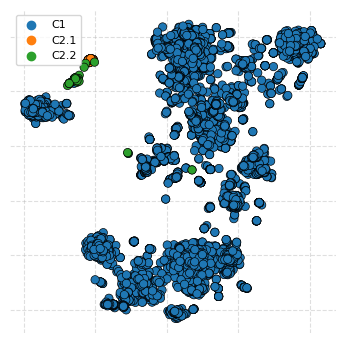

In [31]:
# remove the c_n labels 
fs_clust_1 = [x[3:] for x in clean_clust_1]
fs_clust_2 = [x[3:] for x in clean_clust_2]


conditions = [
    sbl_c.model.isin(fs_clust_1),
    sbl_c.model.isin(fs_clust_2),

]

values2 = ["C2.1", "C2.2"]

sbl_c["foldseek_cluster"] = np.select(conditions, values2)
sbl_c["foldseek_cluster"] = sbl_c["foldseek_cluster"].str.replace("0", "C1")
#sbl_c["group"] = sbl_c["group"].str.replace("CC012", "C02")

plt.figure(figsize=(4.2,4.2))
ax=sns.scatterplot(sbl_c.sort_values("foldseek_cluster", ascending=True), 
                   x="tsne1_esm1b_400", y="tsne2_esm1b_400", hue="foldseek_cluster",alpha=1, edgecolor = "black", palette="tab10")
ax.grid(alpha=0.4, linestyle="--")
ax.set_frame_on(False)
ax.legend(frameon=True, fontsize=8)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_ylabel("")
ax.set_xlabel("")
ax.tick_params(axis='both', colors='white')
ax.set_axisbelow(True)

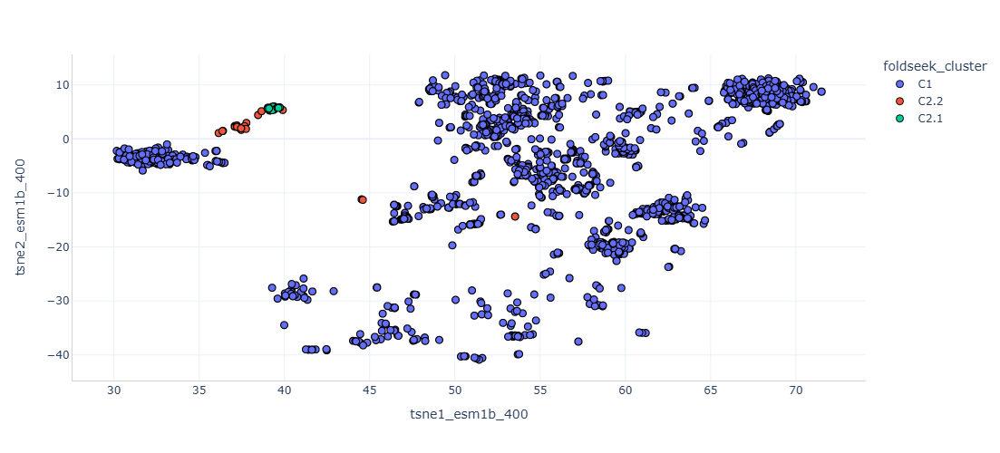

In [32]:
do_iscatter_normal(
    df=sbl_c[sbl_c.has_af2_model =="yes"], 
    x='tsne1_esm1b_400', 
    y='tsne2_esm1b_400', 
    hue="foldseek_cluster", hover_name="protein_name", hover_data=["uniprotAccession", "model"])

In [33]:
# outliers 
outliers = sbl_c[
    (sbl_c.tsne1_esm1b_400.between(53,54)) & 
    (sbl_c.tsne2_esm1b_400.between(-15, -14)) & 
    (sbl_c.model.notnull())
]

print(f"n = {len(outliers)}")
outliers[["model"]]

n = 2


,model
16360,AF-A0A4P6A1I7-F1-model_v4.pdb
16361,AF-A0A1B6NWU7-F1-model_v4.pdb


In [34]:
# c2.1
c2_1 = sbl_c[
    (sbl_c.tsne1_esm1b_400.between(38,40)) & 
    (sbl_c.tsne2_esm1b_400.between(4, 6.5)) & 
    (sbl_c.model.notnull())
]
print(f"n = {len(c2_1)}")
c2_1[["model"]]

n = 41


,model
15514,AF-A0A1Q7BAI2-F1-model_v4.pdb
15678,AF-A0A2M8R873-F1-model_v4.pdb
15679,AF-A0A0S6UYA9-F1-model_v4.pdb
15681,AF-A0A0R3C9H5-F1-model_v4.pdb
15683,AF-A0A1C3X1R1-F1-model_v4.pdb
15685,AF-A0A0X8CJL5-F1-model_v4.pdb
15686,AF-A0A150Z781-F1-model_v4.pdb
15687,AF-A0A1Q5SC68-F1-model_v4.pdb
15689,AF-A0A1Q5SVS4-F1-model_v4.pdb
15691,AF-A0A160UVB3-F1-model_v4.pdb


In [35]:
# c2.2
c2_2 = sbl_c[
    (sbl_c.tsne1_esm1b_400.between(36,38)) & 
    (sbl_c.tsne2_esm1b_400.between(0, 4)) & 
    (sbl_c.model.notnull())
]

print(f"n = {len(c2_2)}")
c2_2[["model"]]

n = 31


,model
16324,AF-A0A2N2F5X1-F1-model_v4.pdb
16393,AF-A0A1M3CPB4-F1-model_v4.pdb
19138,AF-A0A2N4X815-F1-model_v4.pdb
19492,AF-A0A1G0GUA0-F1-model_v4.pdb
19493,AF-A0A1G0HVX8-F1-model_v4.pdb
19494,AF-A0A357MR87-F1-model_v4.pdb
19535,AF-Q5WU35-F1-model_v4.pdb
19536,AF-A0A378KGS2-F1-model_v4.pdb
19540,AF-A0A378K6N4-F1-model_v4.pdb
19555,AF-A0A3A6V579-F1-model_v4.pdb


In [36]:
# fused fold 
c2_2[c2_2.model == "AF-A0A2N4X815-F1-model_v4.pdb"].seq_id

19138    bldb_019139
Name: seq_id, dtype: object

In [37]:
# a fx to export fasta seqs
def export_fasta(df, output_file):
    with open(output_file, 'w') as f:
        for index, row in df.iterrows():
            f.write(f'>{row["seq_id"]}\n')
            f.write(f'{row["seq"]}\n')
 
export_fasta(c2_1,"../bldb/clean/fasta/class_c/c2_1_rep90_final.fasta")
export_fasta(c2_2,"../bldb/clean/fasta/class_c/c2_2_rep90_final.fasta")

In [38]:
c2_1_names = c2_1.model.to_list()
c2_2_names = c2_2.model.to_list()

In [39]:
pdb_files = "../bldb/af2/class_c/comparison/"
clone_dir = "../bldb/af2/class_c/comparison/c2_1/"

In [40]:
# copy the files 
#for pdb in tqdm(c2_1_names, desc="Working"):
#    filename = os.path.join(pdb_files, pdb)
#    if os.path.exists(filename):
#        shutil.copy(filename, clone_dir)

In [41]:
clone_dir = "../bldb/af2/class_c/comparison/c2_2/"

# copy the files 
#for pdb in tqdm(c2_2_names, desc="Working"):
#    filename = os.path.join(pdb_files, pdb)
#    if os.path.exists(filename):
#        shutil.copy(filename, clone_dir)

# chimeraX check 

In [134]:
# after a chimerax check we detected this outliers 
chimera_filter = [
    # is C1
    "C2-AF-D6MLY8-F1-model_v4.pdb",
    "C2-AF-I9NK21-F1-model_v4.pdb",
    "C2-AF-A0A0W0SW84-F1-model_v4.pdb",
    "C2-AF-A0A1G0GUA0-F1-model_v4.pdb",
    "C2-AF-A0A1G0HVX8-F1-model_v4.pdb",
    "C2-AF-A0A1G0WYI0-F1-model_v4.pdb",
    "C2-AF-A0A2N2F5X1-F1-model_v4.pdb",
    "C2-AF-A0A059X9F8-F1-model_v4.pdb",
    "C2-AF-A0A357MR87-F1-model_v4.pdb",
    
    # fused folds
    "C2-AF-F4CDQ9-F1-model_v4.pdb",
    "C2-AF-A0A0X8CJL5-F1-model_v4.pdb"
]

foldseek2 = foldseek[~foldseek['query'].isin(chimera_filter) & ~foldseek['target'].isin(chimera_filter)]
foldseek2

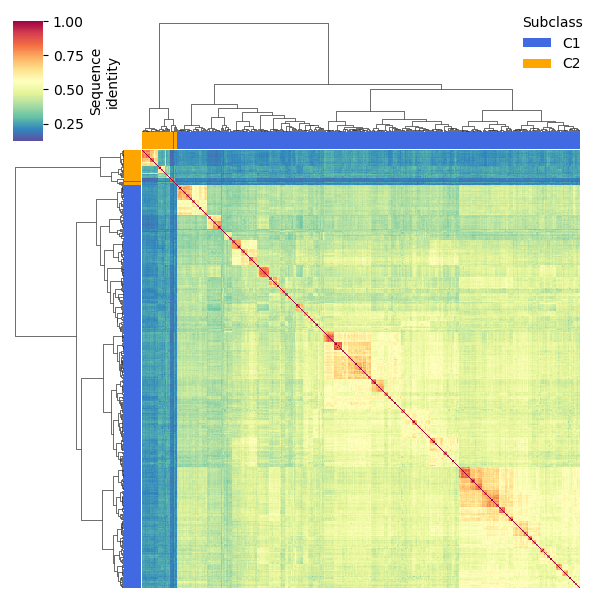

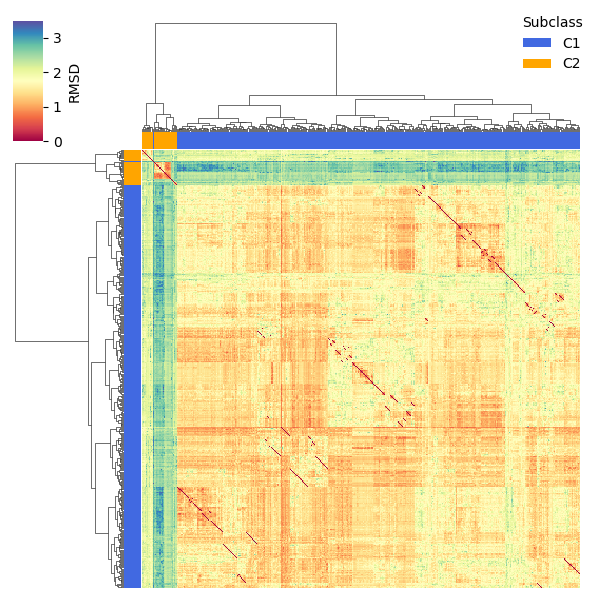

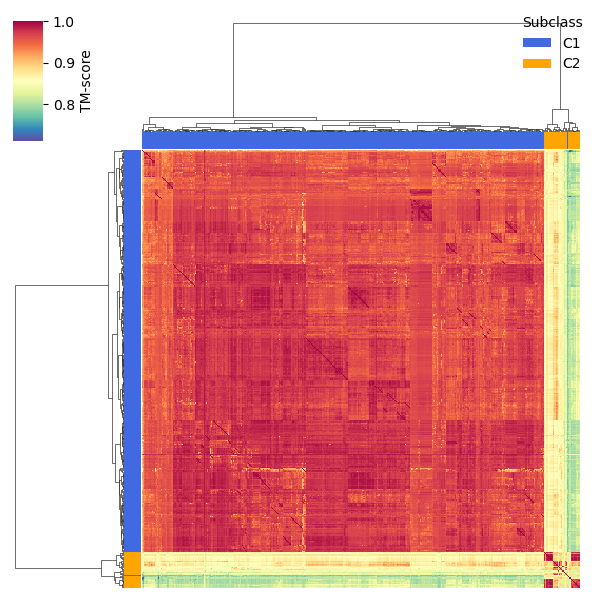

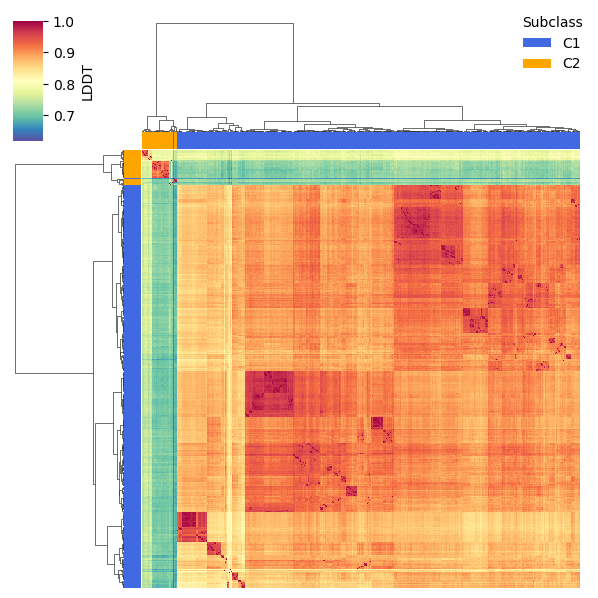

In [136]:
plot_clustermap(foldseek2, 'fident', 'Sequence\nidentity', "Spectral_r")
plot_clustermap(foldseek2, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(foldseek2, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(foldseek2, 'lddt', 'LDDT', "Spectral_r")

fin

In [97]:
foldseek[foldseek["query"].str.contains("A0A0S6UYA9")].sort_values("fident", ascending=False).head(35)

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
18361,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,0.0000,1.0000,1.000,1.0000,1.0000,0,0.000
18366,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A0X8CJL5-F1-model_v4.pdb,0.8229,0.9893,0.877,0.9426,0.9402,89,0.996
18364,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A150U726-F1-model_v4.pdb,0.5108,0.9956,0.851,0.9630,0.9445,90,0.996
18372,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A2M8R873-F1-model_v4.pdb,1.5140,0.9729,0.847,0.9492,0.9264,93,0.998
18374,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A2A6PXS3-F1-model_v4.pdb,1.6370,0.9670,0.824,0.9402,0.9191,91,0.997
18362,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A176Z1I5-F1-model_v4.pdb,0.6448,0.9936,0.817,0.9617,0.9452,89,0.996
18367,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A1Q5SC68-F1-model_v4.pdb,0.8859,0.9873,0.789,0.9408,0.9381,89,0.996
18377,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A0E4FZF5-F1-model_v4.pdb,1.9760,0.9376,0.783,0.9174,0.8940,92,0.997
18369,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A1I5JRQ1-F1-model_v4.pdb,0.7394,0.9784,0.775,0.9582,0.9354,89,0.996
18373,C2-AF-A0A0S6UYA9-F1-model_v4.pdb,C2-AF-A0A2A2VFU2-F1-model_v4.pdb,1.3920,0.9800,0.719,0.9268,0.9218,90,0.996


/tmp/ipykernel_545/3219010574.py:44: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



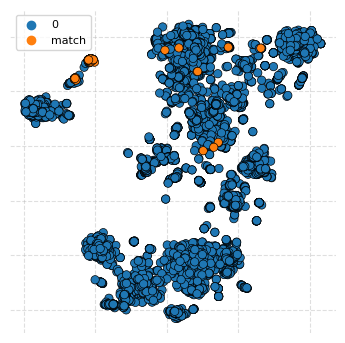

In [161]:
real_c2 = [
    "AF-A0A0X8CJL5-F1-model_v4.pdb",
    "AF-A0A150U726-F1-model_v4.pdb",
    "AF-A0A2M8R873-F1-model_v4.pdb",
    "AF-A0A2A6PXS3-F1-model_v4.pdb",
    "AF-A0A176Z1I5-F1-model_v4.pdb",
    "AF-A0A1Q5SC68-F1-model_v4.pdb",
    "AF-A0A0E4FZF5-F1-model_v4.pdb",
    "AF-A0A1I5JRQ1-F1-model_v4.pdb",
    "AF-A0A2A2VFU2-F1-model_v4.pdb",
    "AF-A0A2K8YCN2-F1-model_v4.pdb",
    "AF-A0A1G6YBU7-F1-model_v4.pdb",
    "AF-A0A1B9Z423-F1-model_v4.pdb",
    "AF-A0A0R3L3S1-F1-model_v4.pdb",
    "AF-A0A2A6NYE4-F1-model_v4.pdb",
    "AF-A0A1M5KSS1-F1-model_v4.pdb",
    "AF-A0A257KTN7-F1-model_v4.pdb",
    "AF-A0A1Q7BAI2-F1-model_v4.pdb",
    "AF-A0A378JVI9-F1-model_v4.pdb",
    "AF-A0A1M3CPB4-F1-model_v4.pdb",
    "AF-A0A0C1EPQ2-F1-model_v4.pdb",
    "AF-Q5ZSV4-F1-model_v4.pdb",
    "AF-A0A0W0YYQ6-F1-model_v4.pdb",
    "AF-A0A7V1BT41-F1-model_v4.pdb",
    "AF-A0A0X8P4L8-F1-model_v4.pdb",
    "AF-A0A2H9STI3-F1-model_v4.pdb",
    "AF-A0A378KWB1-F1-model_v4.pdb",
    "AF-I3XEC9-F1-model_v4.pdb",
    "AF-A0A1X7LSH6-F1-model_v4.pdb",
    "AF-A0A249NYE2-F1-model_v4.pdb",
    "AF-A0A2N7VDN3-F1-model_v4.pdb",
    "AF-A0A010SUD7-F1-model_v4.pdb",
    "AF-A0A1W0CQ20-F1-model_v4.pdb",
    "AF-A0A0C1C531-F1-model_v4.pdb",
    "AF-A0A2V0QV54-F1-model_v4.pdb"
]

filters = [
    sbl_c.model.isin(real_c2),
]

values = ["match"]

sbl_c["real_c2"] = np.select(filters, values)
#sbl_c["group"] = sbl_c["group"].str.replace("CC012", "C02")

plt.figure(figsize=(4.2,4.2))
ax=sns.scatterplot(sbl_c.sort_values("real_c2", ascending=True), 
                   x="tsne1_esm1b_400", y="tsne2_esm1b_400", hue="real_c2",alpha=1, edgecolor = "black", palette="tab10")
ax.grid(alpha=0.4, linestyle="--")
ax.set_frame_on(False)
ax.legend(frameon=True, fontsize=8)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_ylabel("")
ax.set_xlabel("")
ax.tick_params(axis='both', colors='white')
ax.set_axisbelow(True)

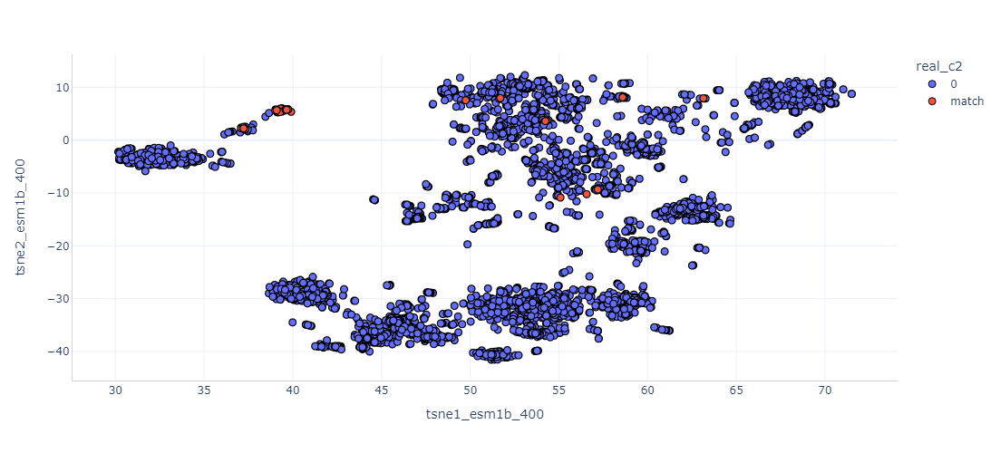

In [162]:
do_iscatter_normal(
    df=sbl_c, 
    x='tsne1_esm1b_400', 
    y='tsne2_esm1b_400', 
    hue="real_c2", hover_name="protein_name", hover_data=["uniprotAccession", "model"])

In [166]:
sbl_c[(sbl_c.tsne1_esm1b_400.between(45,65)) & (sbl_c.real_c2 =="match")][["model"]]

,model
14718,AF-A0A0X8P4L8-F1-model_v4.pdb
16193,AF-A0A2N7VDN3-F1-model_v4.pdb
16195,AF-A0A1X7LSH6-F1-model_v4.pdb
16362,AF-A0A7V1BT41-F1-model_v4.pdb
16405,AF-A0A1W0CQ20-F1-model_v4.pdb
19261,AF-A0A249NYE2-F1-model_v4.pdb
19267,AF-I3XEC9-F1-model_v4.pdb
20633,AF-A0A010SUD7-F1-model_v4.pdb
20796,AF-A0A2V0QV54-F1-model_v4.pdb


In [134]:
def export_fasta(df, output_file):
    with open(output_file, 'w') as f:
        for index, row in df.iterrows():
            f.write(f'>{row["seq_id"]}\n')
            f.write(f'{row["seq"]}\n')
 
export_fasta(sbl_c, "/home/gama/desk/bla/bldb/af2/class_c/one_search/diamond/sbl_c.fa")

In [135]:
sbl_c[sbl_c.model == "AF-A0A0S6UYA9-F1-model_v4.pdb"].seq_id.values[0]

'bldb_015680'

In [136]:
sbl_c[sbl_c.model == "AF-A0A0S6UYA9-F1-model_v4.pdb"].seq.values[0]

'MPPVVISSPITRRIFARAASISMAVALCPRRAPADSDMIAQMRDIVAGALAPTATPDHAGGLAAALYAGRHVEFFSYGFADGATRRKVTPDTLFNLASLRKPFEATLVALGVLRGELRLDDRLPKYLPELSGNTIRNVTVGQLATHTSGLLLPTDHPPWPDEEYTREQFMAMLNAFTPAPGVAPGRQRVYTHAGYVLLQLVLERRYGMPIAALLEQRILSPLGMTATCVPERGEDNRAVMDEAWMQRVVQGYSDQGVAIGPIGNQQSYFDVPGTGQMFSSARDLATFVAACVDGRAIDPHLREALRLTLREAFRVDEKFGQGMAWETVRLPGVTVVDKPGGLNNASGYIGLVPARRIGIVLLANRGEYPHEIARYKILPELARLMASH'

In [140]:
di_cols = ["query", "seq_id", "ident", "length", "mismatch", "gapopen", "qstart", "qend", "sstart", "send", "evalue", "bitscore"]

diamond = pd.read_csv("/home/gama/desk/bla/bldb/af2/class_c/one_search/diamond/diamon_results.csv", sep="\t", names=di_cols)
diamond

,query,seq_id,ident,length,mismatch,gapopen,qstart,qend,sstart,send,evalue,bitscore
0,bldb_015680,bldb_015680,100.0,388,0,0,1,388,1,388,3.260000e-282,762.0
1,bldb_015680,bldb_015681,90.4,366,35,0,23,388,1,366,2.700000e-239,652.0
2,bldb_015680,bldb_015685,84.3,388,60,1,1,388,1,387,9.740000e-238,649.0
3,bldb_015680,bldb_015684,89.1,366,40,0,23,388,1,366,1.050000e-236,646.0
4,bldb_015680,bldb_015683,88.8,366,41,0,23,388,1,366,3.010000e-236,645.0
...,...,...,...,...,...,...,...,...,...,...,...,...
6753,bldb_015680,bldb_021218,21.6,306,203,10,69,364,53,331,1.190000e-07,50.8
6754,bldb_015680,bldb_021143,24.2,306,188,10,73,364,55,330,1.580000e-07,50.4
6755,bldb_015680,bldb_021215,22.3,310,196,11,69,364,53,331,2.110000e-07,50.1
6756,bldb_015680,bldb_019525,23.4,334,212,9,61,378,58,363,1.620000e-06,47.4


In [150]:
xd = sbl_c.copy()
xd = xd.merge(diamond, on="seq_id",how="left")

/home/gama/anaconda3/envs/bio/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



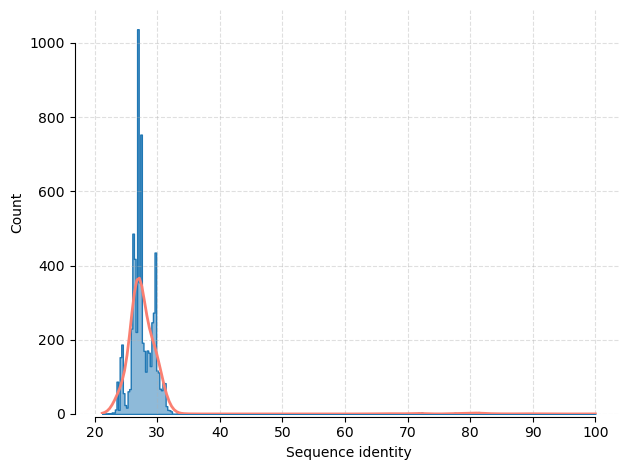

In [155]:
axs=sns.histplot(xd, x="ident", element="step", kde=True, line_kws={'color':'black', 'lw': 2})
axs.grid(alpha=0.4, linestyle="--")
sns.despine(trim=True, offset=2)
axs.set_xlabel("Sequence identity")
axs.lines[0].set_color('salmon')
plt.tight_layout()
plt.show()

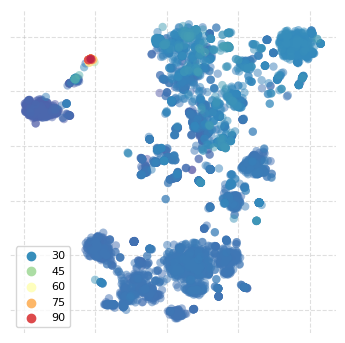

In [156]:
plt.figure(figsize=(4.2,4.2))
ax=sns.scatterplot(xd.sort_values("ident"), 
                   x="tsne1_esm1b_400", y="tsne2_esm1b_400", hue="ident",alpha=0.5, edgecolor = "none", palette="Spectral_r")
ax.grid(alpha=0.4, linestyle="--")
ax.set_frame_on(False)
ax.legend(frameon=True, fontsize=8)
ax.set_yticklabels([])
ax.set_xticklabels([])
ax.set_ylabel("")
ax.set_xlabel("")
ax.tick_params(axis='both', colors='white')
ax.set_axisbelow(True)

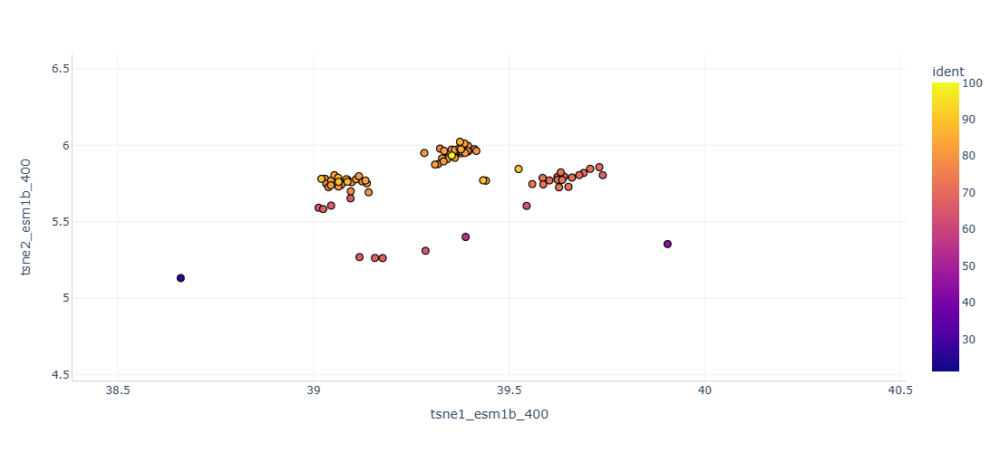

In [149]:
do_iscatter_normal(
    df=xd.sort_values("ident"), 
    x='tsne1_esm1b_400', 
    y='tsne2_esm1b_400', 
    hue="ident", hover_name="protein_name", hover_data=["uniprotAccession", "model"])

# whole dset

In [82]:
folds = pd.read_csv("../bldb/af2/class_c/search/foldseek/foldseek_results.csv", sep="\t", names=foldseek_cols)
folds

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,AF-J2L2H2-F1-model_v4.pdb,AF-J2L2H2-F1-model_v4.pdb,0.02401,1.0000,1.000,1.0000,1.0000,0,0.000
1,AF-J2L2H2-F1-model_v4.pdb,AF-A0A0Q5NUL0-F1-model_v4.pdb,1.24000,0.9791,0.447,0.9165,0.9712,97,0.999
2,AF-J2L2H2-F1-model_v4.pdb,AF-A0A158BQK9-F1-model_v4.pdb,1.46400,0.9735,0.434,0.9079,0.9643,96,0.999
3,AF-J2L2H2-F1-model_v4.pdb,AF-A0A7Y7XVS6-F1-model_v4.pdb,1.16700,0.9773,0.429,0.9078,0.9618,96,0.999
4,AF-J2L2H2-F1-model_v4.pdb,AF-A0A109EL26-F1-model_v4.pdb,1.40500,0.9739,0.431,0.8894,0.9616,96,0.999
...,...,...,...,...,...,...,...,...,...
182324,AF-A0A0Q8BK81-F1-model_v4.pdb,AF-A0A2I0P428-F1-model_v4.pdb,2.61400,0.7799,0.205,0.7169,0.7693,76,0.971
182325,AF-A0A0Q8BK81-F1-model_v4.pdb,AF-A0A1G6YBU7-F1-model_v4.pdb,2.52100,0.7995,0.270,0.7087,0.7630,76,0.971
182326,AF-A0A0Q8BK81-F1-model_v4.pdb,AF-A0A0E4FZF5-F1-model_v4.pdb,2.72100,0.7931,0.268,0.7091,0.7521,76,0.971
182327,AF-A0A0Q8BK81-F1-model_v4.pdb,AF-A0A2N4X815-F1-model_v4.pdb,2.08400,0.8088,0.248,0.7191,0.7036,75,0.967


In [83]:
# apply the rename-fx 
folds["query"]  = folds["query"].apply(lambda x: rename_file(x, names_lists))
folds["target"] = folds["target"].apply(lambda x: rename_file(x, names_lists))
folds

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
0,C1-AF-J2L2H2-F1-model_v4.pdb,C1-AF-J2L2H2-F1-model_v4.pdb,0.02401,1.0000,1.000,1.0000,1.0000,0,0.000
1,C1-AF-J2L2H2-F1-model_v4.pdb,C1-AF-A0A0Q5NUL0-F1-model_v4.pdb,1.24000,0.9791,0.447,0.9165,0.9712,97,0.999
2,C1-AF-J2L2H2-F1-model_v4.pdb,C1-AF-A0A158BQK9-F1-model_v4.pdb,1.46400,0.9735,0.434,0.9079,0.9643,96,0.999
3,C1-AF-J2L2H2-F1-model_v4.pdb,C1-AF-A0A7Y7XVS6-F1-model_v4.pdb,1.16700,0.9773,0.429,0.9078,0.9618,96,0.999
4,C1-AF-J2L2H2-F1-model_v4.pdb,C1-AF-A0A109EL26-F1-model_v4.pdb,1.40500,0.9739,0.431,0.8894,0.9616,96,0.999
...,...,...,...,...,...,...,...,...,...
182324,C1-AF-A0A0Q8BK81-F1-model_v4.pdb,C2-AF-A0A2I0P428-F1-model_v4.pdb,2.61400,0.7799,0.205,0.7169,0.7693,76,0.971
182325,C1-AF-A0A0Q8BK81-F1-model_v4.pdb,C2-AF-A0A1G6YBU7-F1-model_v4.pdb,2.52100,0.7995,0.270,0.7087,0.7630,76,0.971
182326,C1-AF-A0A0Q8BK81-F1-model_v4.pdb,C2-AF-A0A0E4FZF5-F1-model_v4.pdb,2.72100,0.7931,0.268,0.7091,0.7521,76,0.971
182327,C1-AF-A0A0Q8BK81-F1-model_v4.pdb,C2-AF-A0A2N4X815-F1-model_v4.pdb,2.08400,0.8088,0.248,0.7191,0.7036,75,0.967


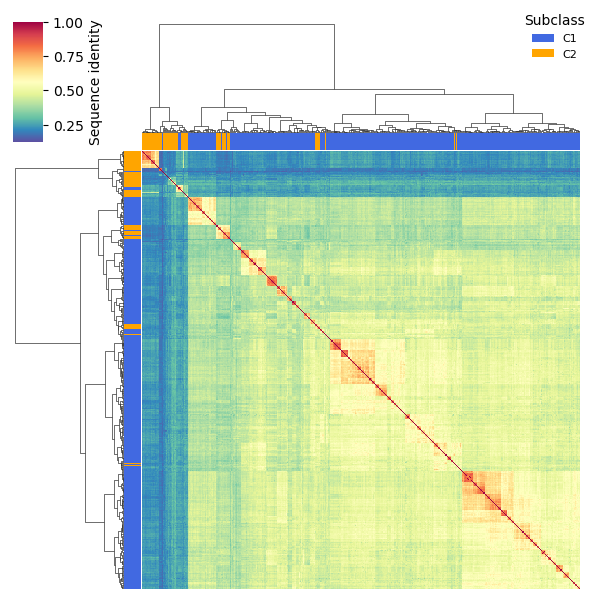

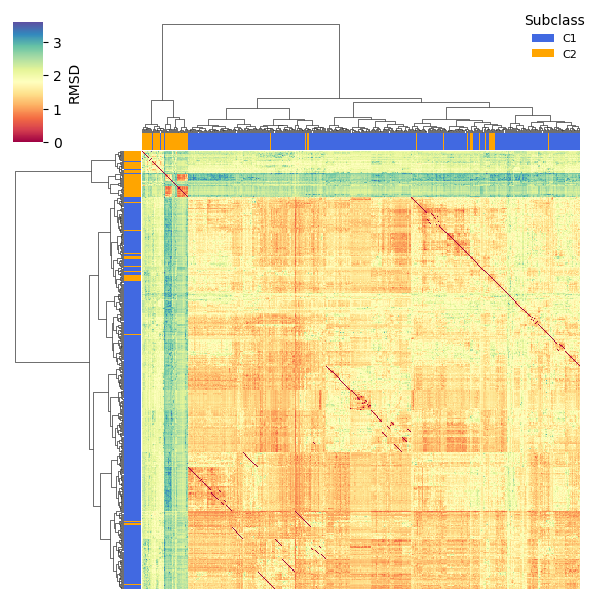

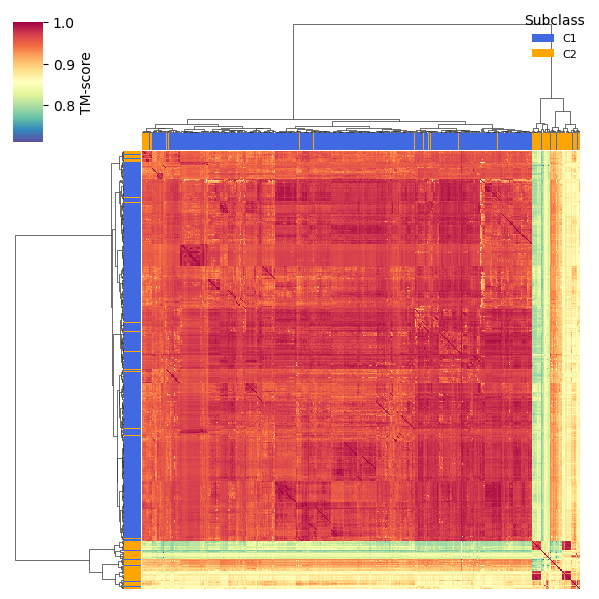

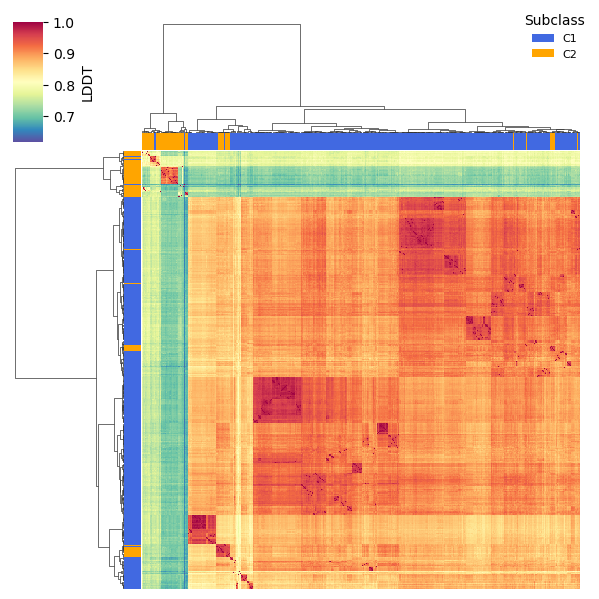

In [84]:
plot_clustermap(folds, 'fident', 'Sequence identity', "Spectral_r")
plot_clustermap(folds, 'rmsd', 'RMSD', "Spectral")
plot_clustermap(folds, 'alntmscore', 'TM-score', "Spectral_r")
plot_clustermap(folds, 'lddt', 'LDDT', "Spectral_r")

In [86]:
folds[folds.fident < 1.0].sort_values("prob").head(10)

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
101621,C2-AF-F4CDQ9-F1-model_v4.pdb,C1-AF-B1LXB8-F1-model_v4.pdb,1.970,0.8269,0.219,0.7097,0.6769,53,0.569
46965,C2-AF-A0A2N4X815-F1-model_v4.pdb,C1-AF-B1LXB8-F1-model_v4.pdb,1.864,0.8128,0.213,0.6937,0.6767,54,0.601
101300,C2-AF-F4CDQ9-F1-model_v4.pdb,C1-AF-A0A132SCF9-F1-model_v4.pdb,1.805,0.8522,0.216,0.7315,0.7139,58,0.720
46696,C2-AF-A0A2N4X815-F1-model_v4.pdb,C1-AF-A0A132SCF9-F1-model_v4.pdb,1.978,0.8377,0.232,0.7116,0.7139,59,0.747
101222,C2-AF-F4CDQ9-F1-model_v4.pdb,C2-AF-A0A1Q7BAI2-F1-model_v4.pdb,1.892,0.8614,0.229,0.7551,0.7302,60,0.772
101507,C2-AF-F4CDQ9-F1-model_v4.pdb,C1-AF-A0A0Q7YPI5-F1-model_v4.pdb,2.276,0.8097,0.211,0.7111,0.7056,61,0.795
101588,C2-AF-F4CDQ9-F1-model_v4.pdb,C1-AF-A0A4P6A1I7-F1-model_v4.pdb,2.621,0.8311,0.162,0.6865,0.6991,61,0.795
101380,C2-AF-F4CDQ9-F1-model_v4.pdb,C2-AF-L7UG55-F1-model_v4.pdb,2.634,0.8455,0.211,0.7254,0.7102,61,0.795
101548,C2-AF-F4CDQ9-F1-model_v4.pdb,C1-AF-D4GF03-F1-model_v4.pdb,2.132,0.8066,0.205,0.7202,0.7032,61,0.795
101477,C2-AF-F4CDQ9-F1-model_v4.pdb,C1-AF-W6VT56-F1-model_v4.pdb,2.045,0.8235,0.227,0.7341,0.7067,62,0.817


In [87]:
folds[folds.fident < 1.0].sort_values("rmsd").head(10)

,query,target,rmsd,alntmscore,fident,lddt,evalue,bits,prob
17081,C1-AF-A0A141RN41-F1-model_v4.pdb,C1-AF-I1VZ30-F1-model_v4.pdb,0.4069,0.9974,0.724,0.9935,0.9968,99,0.999
109313,C1-AF-I1VZ30-F1-model_v4.pdb,C1-AF-A0A141RN41-F1-model_v4.pdb,0.4072,0.9974,0.724,0.9936,0.9968,99,0.999
31172,C1-AF-A0A059L3Q3-F1-model_v4.pdb,C1-AF-J3G6G7-F1-model_v4.pdb,0.4183,0.9974,0.802,0.9897,0.9969,99,0.999
83693,C1-AF-J3G6G7-F1-model_v4.pdb,C1-AF-A0A059L3Q3-F1-model_v4.pdb,0.4184,0.9974,0.802,0.9896,0.9969,99,0.999
44836,C1-AF-J2NR83-F1-model_v4.pdb,C1-AF-J2YF63-F1-model_v4.pdb,0.4573,0.9968,0.734,0.9798,0.9821,96,0.999
8117,C1-AF-J2YF63-F1-model_v4.pdb,C1-AF-J2NR83-F1-model_v4.pdb,0.4576,0.9968,0.734,0.9828,0.9821,99,0.999
170374,C1-AF-A0A0D8KDJ3-F1-model_v4.pdb,C1-AF-A0A7L5BL93-F1-model_v4.pdb,0.4812,0.9964,0.849,0.9906,0.9956,99,0.999
115291,C1-AF-A0A7L5BL93-F1-model_v4.pdb,C1-AF-A0A0D8KDJ3-F1-model_v4.pdb,0.4814,0.9964,0.849,0.9907,0.9956,99,0.999
17082,C1-AF-A0A141RN41-F1-model_v4.pdb,C1-AF-Q5XPQ7-F1-model_v4.pdb,0.4897,0.9962,0.793,0.9893,0.9928,99,0.999
75580,C1-AF-Q5XPQ7-F1-model_v4.pdb,C1-AF-A0A141RN41-F1-model_v4.pdb,0.4899,0.9962,0.793,0.9853,0.9928,99,0.999
